<a href="https://colab.research.google.com/github/kevzhu14/NeurIPS-Open-Polymer-Prediction/blob/main/Preliminary_Statistical_Analysis.ipynb" target="_parent"><img src="https://colab.research.google.com/assets/colab-badge.svg" alt="Open In Colab"/></a>

[![Open In Colab](https://colab.research.google.com/assets/colab-badge.svg)](https://colab.research.google.com/github/AI4ChemS/CHE-1147/blob/main/tutorials/tutorial_03_eda_and_rdkit.ipynb)

# Getting Started with RDKit

**RDKit** (RD stands for "Rational Drug Design") is an open-source cheminformatics toolkit for working with chemical data.

Key capabilities include:

- **Molecular representation:** Convert chemical names or formulas into machine-readable formats such as SMILES or RDKit Mol objects, and transform 2-D or 3-D structures into data that machine learning (ML) algorithms can process.

- **Feature engineering:** Compute molecular descriptors (like molecular weight) and generate fingerprints that encode each molecule as a fixed-length numerical vector that can be used for regression or classification tasks.

- **Chemical similarity:** Quantify how alike two molecules are using metrics such as the Tanimoto coefficient, enabling tasks like clustering chemical libraries, virtual screening of large databases, and property prediction.

- **Pattern recognition:** Search structures for functional groups or other key motifs, and automatically identify reaction sites or core molecular scaffolds for further analysis.


By mastering RDKit, you'll be able to:  
- Analyze chemical datasets efficiently
- Connect molecular structure to chemical and physical properties
- Build predictive machine learning models for molecular properties

Further reading:
- [RDKit Documentation](https://www.rdkit.org/docs/) - Comprehensive RDKit guide
- [RDKit Cookbook](https://www.rdkit.org/docs/Cookbook.html) - Practical examples and recipes
- [Greg Landrum's RDKit Blog](https://greglandrum.github.io/rdkit-blog/) - Advanced tutorials and tips


# 1. Installation

If you're working on your local machine, you can install by running:
```bash
pip install rdkit
```
or for conda:
```bash
conda install -c rdkit rdkit
```


In [ ]:
# or for Colab, uncomment:
!pip install rdkit

Water molecule: O


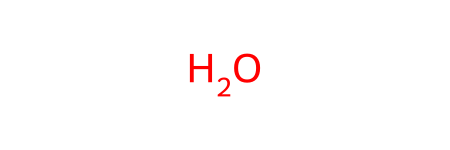

In [ ]:
# Import packages
import pandas as pd
import numpy as np
from rdkit import Chem
from rdkit.Chem import Draw, Descriptors

# Test installation by printing a simple molecule
water = Chem.MolFromSmiles('O')
print(f"Water molecule: {Chem.MolToSmiles(water)}")

# Test molecule visualization
water


# 2. Molecular Representations

## SMILES (Simplified Molecular Input Line Entry System)

SMILES encodes a molecule’s structure as a compact line notation, turning a 2-D chemical diagram into a single text string that computers can parse. It represents:
- **Atoms:** Element symbols like C (carbon), N (nitrogen), O (oxygen)
- **Bonds:** Single bonds implicit, double bonds (=), triple bonds (#)
- **Rings:** Numbers mark ring closures so the string can “loop back”
- **Branches:** Parentheses show side chains branching off the main backbone

Some examples of SMILES:
- Water: `O`
- Ethanol: `CCO`
- Benzene: `c1ccccc1`
- Caffeine: `CN1C=NC2=C1C(=O)N(C(=O)N2C)C`

## RDKit Mol Objects

An RDKit **Mol object** is a computer-readable representation of a molecule. It stores the full molecular graphs/atoms and their chemical information.  This goes beyond a plain SMILES string, which is only a line of text. The SMILES format is ideal for storage and quick exchange, but the Mol object is the working format that lets you analyze, manipulate, and calculate properties directly in RDKit.


In [ ]:
# Create molecules from SMILES
molecules = {
    'Water': 'O',
    'Methane': 'C',
    'Ethanol': 'CCO',
    'Benzene': 'c1ccccc1',
    'Caffeine': 'CN1C=NC2=C1C(=O)N(C(=O)N2C)C'
}

# Convert SMILES to RDKit mol objects
mol_objects = {}
for name, smiles in molecules.items():
    mol = Chem.MolFromSmiles(smiles)
    mol_objects[name] = mol
    print(f"{name}: {smiles}")


Water: O
Methane: C
Ethanol: CCO
Benzene: c1ccccc1
Caffeine: CN1C=NC2=C1C(=O)N(C(=O)N2C)C


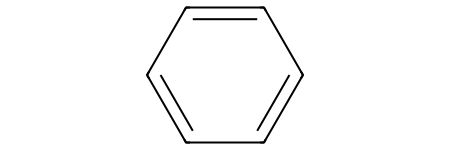

In [ ]:
# Display the benzene molecule
mol_objects['Benzene']

In [ ]:
# Check some basic molecular properties
benzene = mol_objects['Benzene']

print(f"Number of atoms: {benzene.GetNumAtoms()}")
print(f"Number of bonds: {benzene.GetNumBonds()}")
print(f"Molecular formula: {Chem.rdMolDescriptors.CalcMolFormula(benzene)}")
print(f"Molecular weight: {Descriptors.MolWt(benzene):.2f} g/mol")


Number of atoms: 6
Number of bonds: 6
Molecular formula: C6H6
Molecular weight: 78.11 g/mol


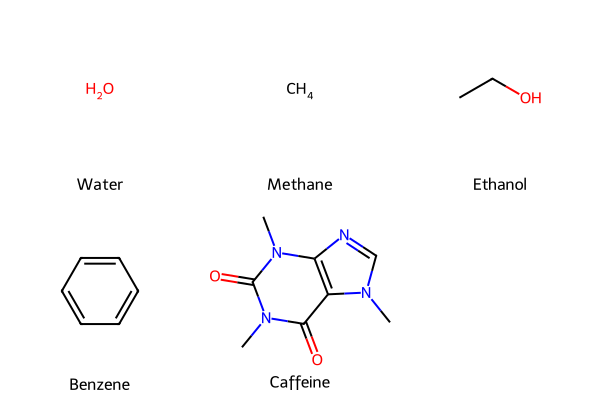

In [ ]:
# Visualize multiple molecules in a grid using MolsToGridImage
mol_list = list(mol_objects.values())
names = list(mol_objects.keys())

Draw.MolsToGridImage(mol_list, molsPerRow=3, legends=names, subImgSize=(200, 200))


## SMILES Canonicalization

A single molecule can be written with multiple valid SMILES strings.  
*Canonical SMILES* provide a **unique, standardized representation**, ensuring that the same molecule is always encoded the same way.

Examples of non-canonical SMILES for acetic acid:
- `CC(=O)O`
- `C(C(=O)O)`
- `OC(=O)C`

All represent the same molecule but look different!


In [ ]:
# Different SMILES for the same molecule (acetic acid)
acetic_acid_variants = [
    'CC(=O)O',
    'C(C(=O)O)',
    'OC(=O)C'
]

# Convert to mol objects and back to canonical SMILES
canonical_smiles = []
for smiles in acetic_acid_variants:
    mol = Chem.MolFromSmiles(smiles)
    canonical = Chem.MolToSmiles(mol)  # This canonicalizes
    canonical_smiles.append(canonical)
    print(f"Original: {smiles}")
    print(f"Canonical: {canonical}")
    print()


Original: CC(=O)O
Canonical: CC(=O)O

Original: C(C(=O)O)
Canonical: CC(=O)O

Original: OC(=O)C
Canonical: CC(=O)O



We can control whether stereochemistry and isotopic information are written into the SMILES string. RDKit outputs only the connectivity (which atoms are bonded). By setting `isomericSmiles=True` the SMILES will preserve:
- Stereocenters (`@`,`@@`) and double-bond cis/trans (`/`, `\`)
- Isotopes (e.g. `[13C]`)

The function below allows changing between these modes using the `isomeric` flag:

In [ ]:
# A function to canonicalize isomeric SMILES
def canonicalize_smiles(smiles, isomeric:bool=True):
    """
    Convert any SMILES to its canonical form.

    Args:
        smiles (str): Input SMILES string

    Returns:
        str: Canonical SMILES
    """
    mol = Chem.MolFromSmiles(smiles)
    if mol is None:
        return None  # Invalid SMILES
    return Chem.MolToSmiles(mol, isomericSmiles=isomeric)

# Test with stereochemistry (fluoroethanol enantiomers)
test_smiles = ["C[C@H](O)F", "C[C@@H](O)F"]

for s in test_smiles:
    print(f"Original: {s}")
    print("  Non-isomeric :", canonicalize_smiles(s, isomeric=False))
    print("  Isomeric     :", canonicalize_smiles(s, isomeric=True))
    print()


Original: C[C@H](O)F
  Non-isomeric : CC(O)F
  Isomeric     : C[C@H](O)F

Original: C[C@@H](O)F
  Non-isomeric : CC(O)F
  Isomeric     : C[C@@H](O)F



### Mini Exercise 1

1. Create mol objects for these important chemical engineering molecules:
   - Ethylene: `C=C`
   - Propylene: `CC=C`
   - Toluene: `Cc1ccccc1`

2. Calculate their molecular weights and number of atoms.

3. Canonicalize these SMILES and verify they give the same result:
   - Toluene: `Cc1ccccc1` vs `c1ccc(C)cc1`


In [ ]:
# Exercise 1 solution space


# 3. Molecular Descriptors

**Molecular descriptors** are numerical features that quantify molecular properties. They convert molecular structure into vectors that ML algorithms can use.

Some descriptor categories include:
- **Constitutional:** MW, atom counts, bond counts
- **Topological:** Connectivity indices, molecular complexity
- **Physicochemical:** LogP, TPSA, solubility parameters
- **Electronic:** Partial charges, HOMO-LUMO gaps



In [ ]:
# Calculate important descriptors for benzene
benzene = Chem.MolFromSmiles('c1ccccc1')

# Constitutional descriptors
mw = Descriptors.MolWt(benzene)
heavy_atoms = benzene.GetNumHeavyAtoms()
h_bond_donors = Descriptors.NumHDonors(benzene)
h_bond_acceptors = Descriptors.NumHAcceptors(benzene)

# Physicochemical descriptors
logp = Descriptors.MolLogP(benzene)
tpsa = Descriptors.TPSA(benzene)
rotatable_bonds = Descriptors.NumRotatableBonds(benzene)

# Structural descriptors
aromatic_rings = Descriptors.NumAromaticRings(benzene)
rings = Descriptors.RingCount(benzene)

print("Benzene Molecular Descriptors:")
print(f"Molecular Weight: {mw:.2f} g/mol")
print(f"Heavy Atoms: {heavy_atoms}")
print(f"H-bond Donors: {h_bond_donors}")
print(f"H-bond Acceptors: {h_bond_acceptors}")
print(f"LogP: {logp:.2f}")
print(f"TPSA: {tpsa:.2f} Ų")
print(f"Rotatable Bonds: {rotatable_bonds}")
print(f"Aromatic Rings: {aromatic_rings}")
print(f"Total Rings: {rings}")


Benzene Molecular Descriptors:
Molecular Weight: 78.11 g/mol
Heavy Atoms: 6
H-bond Donors: 0
H-bond Acceptors: 0
LogP: 1.69
TPSA: 0.00 Ų
Rotatable Bonds: 0
Aromatic Rings: 1
Total Rings: 1


# 4. Molecular Fingerprints & Similarity

**Molecular fingerprints** encode molecular structure as binary vectors (bit strings). Each bit represents the presence/absence of a specific structural feature.

A common approach is the **Morgan fingerprint**, which encodes circular substructures around each atom. The **radius** controls how many bonds the algorithm explores outward from each atom, while the **length** determines the size of the bit string (typically 1,024 or 2,048 bits). By capturing local chemical environments in this way, Morgan fingerprints provide a consistent numerical description of any molecule.


In [ ]:
from rdkit.Chem import rdFingerprintGenerator

# Create Morgan fingerprint generator
# radius=2 means we look 2 bonds away from each atom
# fpSize=2048 means 2048-bit fingerprint
morgan_gen = rdFingerprintGenerator.GetMorganGenerator(radius=2, fpSize=2048)

# Generate fingerprint for benzene
benzene = Chem.MolFromSmiles('c1ccccc1')
benzene_fp = morgan_gen.GetFingerprint(benzene)

print(f"Fingerprint length: {benzene_fp.GetNumBits()}")
print(f"Number of bits set: {benzene_fp.GetNumOnBits()}")

# Convert to list to see the first few bits
fp_array = benzene_fp.ToList()
print(f"First 20 bits: {fp_array[:20]}")


Fingerprint length: 2048
Number of bits set: 3
First 20 bits: [0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0]


The **Tanimoto coefficient** is then used to compare these fingerprints. This makes it the standard metric for assessing molecular similarity once Morgan fingerprints have been generated. It measures the fraction of shared bits between two molecules relative to the total bits set in either one, giving a score from 0 (no common features) to 1 (identical fingerprints).

In [ ]:
from rdkit.DataStructs import TanimotoSimilarity

# Create molecules for similarity comparison
molecules_sim = {
    'Caffeine': 'CN1C=NC2=C1C(=O)N(C(=O)N2C)C',
    'Theobromine': 'CN1C=NC2=C1C(=O)NC(=O)N2C',    # Similar to caffeine
    'Theophylline': 'CN1C2=C(C(=O)N(C1=O)C)NC=N2', # Similar to caffeine
    'Benzene': 'c1ccccc1',                         # Different structure
    'Toluene': 'Cc1ccccc1'                         # Different structure
}

# Generate fingerprints
fingerprints = {}
for name, smiles in molecules_sim.items():
    mol = Chem.MolFromSmiles(smiles)
    fp = morgan_gen.GetFingerprint(mol)
    fingerprints[name] = fp

# Build similarity matrix as DataFrame
names = list(molecules_sim.keys())
matrix = [
    [TanimotoSimilarity(fingerprints[a], fingerprints[b]) for b in names]
    for a in names
]

similarity_df = pd.DataFrame(matrix, index=names, columns=names)
similarity_df

,Caffeine,Theobromine,Theophylline,Benzene,Toluene
Caffeine,1.000000,0.529412,0.457143,0.037037,0.090909
Theobromine,0.529412,1.000000,0.292683,0.034483,0.085714
Theophylline,0.457143,0.292683,1.000000,0.035714,0.088235
Benzene,0.037037,0.034483,0.035714,1.000000,0.272727
Toluene,0.090909,0.085714,0.088235,0.272727,1.000000


### Mini Exercise 2

1. Calculate Morgan fingerprints for these solvent molecules:
   - Water: `O`
   - Methanol: `CO`
   - Ethanol: `CCO`
   - Propanol: `CCCO`

2. Which alcohol (methanol, ethanol, propanol) is most similar to ethanol?

3. Compare the similarity of water to each alcohol. What do you observe about the trend?


In [ ]:
# Exercise 2 solution space


# 5. Working with Datasets

Real-world cheminformatics projects often involve **large collections of molecules**, and RDKit works smoothly with **pandas** to handle them with DataFrames.

In this example we will test RDKit functions over the **ClinTox dataset**, which contains **1,480 drug-like molecules** represented by SMILES strings. Each entry (row) is tagged to indicate whether the compound is an FDA-approved drug or one that failed clinical trials due to toxicity.


## Introduction to Pandas

**Pandas** (Python Data Analysis Library) is a library for data manipulation and analysis in Python.

Key capabilities include:

- **DataFrames:** Two-dimensional labeled data structures (like spreadsheets) that can store different data types in columns

- **Data loading:** Read data from various formats (CSV, Excel, JSON, databases)

- **Data manipulation:** Filter, sort, group, remove and transform data, allowing you to subset molecular libraries, calculate statistics, and prepare whole datasets for machine learning

## Essential Pandas Functions

Before diving into our dataset, let's understand the key pandas functions we'll use:

- `pd.read_csv()`:
This function loads data from CSV files into a DataFrame. Datasets are commonly stored in CSV format, with each row representing a datapoint (e.g. a molecule) and columns contain descriptors (e.g. SMILES, chemical properties)

- `DataFrame.shape`:
Returns the dimensions of your dataset as (rows, columns). This is a checkpoint to understand whether you're working with hundreds or thousands of datapoints

- `DataFrame.head()`:
Displays the first few rows (default 5) of your dataset. This gives you a quick preview of the data structure, column names, and data types

In [ ]:
# Load dataset using pd.read_csv()
# This function reads the CSV file from a URL and creates a DataFrame
url = "train.csv"
df = pd.read_csv(url)

# Check dataset dimensions using .shape()
print(f"Dataset shape: {df.shape}")

# Show the first few rows with .head()
print("First few rows:")
df.head()

Dataset shape: (7973, 7)
First few rows:


,id,SMILES,Tg,FFV,Tc,Density,Rg
0,87817,*CC(*)c1ccccc1C(=O)OCCCCCC,NaN,0.374645,0.205667,NaN,NaN
1,106919,*Nc1ccc([C@H](CCC)c2ccc(C3(c4ccc([C@@H](CCC)c5...,NaN,0.370410,NaN,NaN,NaN
2,388772,*Oc1ccc(S(=O)(=O)c2ccc(Oc3ccc(C4(c5ccc(Oc6ccc(...,NaN,0.378860,NaN,NaN,NaN
3,519416,*Nc1ccc(-c2c(-c3ccc(C)cc3)c(-c3ccc(C)cc3)c(N*)...,NaN,0.387324,NaN,NaN,NaN
4,539187,*Oc1ccc(OC(=O)c2cc(OCCCCCCCCCOCC3CCCN3c3ccc([N...,NaN,0.355470,NaN,NaN,NaN


As we're interested in getting molecular features using the SMILES , we first canonicalize them to ensure a unique, standardized representation per molecule:

In [ ]:
# Apply the 'canonicalize_smiles' function to the column ['smiles'] and store in new column ['canonical_smiles']
df['canonical_smiles'] = df['SMILES'].apply(canonicalize_smiles)

# Find the SMILES thst changed
# We can create a subset a DataFrame with the entries that are different (!=)
changed = df[df['SMILES'] != df['canonical_smiles']]

print(f"Total changed: {len(changed)}")

# A few examples
for idx, (orig, canon) in changed[['SMILES', 'canonical_smiles']].head(3).iterrows():
    print(f"Original: {orig}  ->  Canonical: {canon}")

Total changed: 17
Original: *C(C)=C(*)[Ge](C)(C)C  ->  Canonical: *C(C)=[C](*)[Ge]([CH3])([CH3])[CH3]
Original: *O[Sn](CCCC)(CCCC)OC(=O)/C=C/C(*)=O  ->  Canonical: *[O][Sn]([CH2]CCC)([CH2]CCC)[O]C(=O)/C=C/C(*)=O
Original: *C=C[Ge](*)(c1ccccc1)c1ccccc1  ->  Canonical: *C=[CH][Ge]([*])([c]1ccccc1)[c]1ccccc1


We can now check the **uniqueness of molecules** before and after canonicalization. Different SMILES strings may represent the same molecule, so counting unique values in both columns helps us see how many entries collapse into a single standardized representation.  

This gives us an idea of dataset redundancy and possible duplicates that should be handled before further analysis or model training. However, duplicates should be handled carefully, since they may reflect valuable datapoints. For instance, the same molecule annotated with different outcomes.

In [ ]:
# Count the unique values with .nunique()
unique_smiles = df['SMILES'].nunique()
unique_canonical = df['canonical_smiles'].nunique()

print(f'Unique SMILES: {unique_smiles}')
print(f'Unique canonical SMILES: {unique_canonical}')

Unique SMILES: 7973
Unique canonical SMILES: 7973


Now our dataset is ready for feature extraction. We convert the canonical SMILES strings into RDKit molecule objects.

`PandasTools.AddMoleculeColumnToFrame()` is an RDKit function that creates RDKit mol objects from SMILES strings in a specified column, and adds a new column to the DataFrame containing these mol objects

In [ ]:
from rdkit.Chem import PandasTools

# Add a column called 'molecule' with mol objects
PandasTools.AddMoleculeColumnToFrame(df, smilesCol='canonical_smiles', molCol='molecule')

df.head()


,id,SMILES,Tg,FFV,Tc,Density,Rg,canonical_smiles,molecule
0,87817,*CC(*)c1ccccc1C(=O)OCCCCCC,NaN,0.374645,0.205667,NaN,NaN,*CC(*)c1ccccc1C(=O)OCCCCCC,<rdkit.Chem.rdchem.Mol object at 0x7bacbe901fc0>
1,106919,*Nc1ccc([C@H](CCC)c2ccc(C3(c4ccc([C@@H](CCC)c5...,NaN,0.370410,NaN,NaN,NaN,*Nc1ccc([C@H](CCC)c2ccc(C3(c4ccc([C@@H](CCC)c5...,<rdkit.Chem.rdchem.Mol object at 0x7bacbe9027a0>
2,388772,*Oc1ccc(S(=O)(=O)c2ccc(Oc3ccc(C4(c5ccc(Oc6ccc(...,NaN,0.378860,NaN,NaN,NaN,*Oc1ccc(S(=O)(=O)c2ccc(Oc3ccc(C4(c5ccc(Oc6ccc(...,<rdkit.Chem.rdchem.Mol object at 0x7bacbe902810>
3,519416,*Nc1ccc(-c2c(-c3ccc(C)cc3)c(-c3ccc(C)cc3)c(N*)...,NaN,0.387324,NaN,NaN,NaN,*Nc1ccc(-c2c(-c3ccc(C)cc3)c(-c3ccc(C)cc3)c(N*)...,<rdkit.Chem.rdchem.Mol object at 0x7bacbe538ac0>
4,539187,*Oc1ccc(OC(=O)c2cc(OCCCCCCCCCOCC3CCCN3c3ccc([N...,NaN,0.355470,NaN,NaN,NaN,*Oc1ccc(OC(=O)c2cc(OCCCCCCCCCOCC3CCCN3c3ccc([N...,<rdkit.Chem.rdchem.Mol object at 0x7bacbe538820>


We can also check how many molecules were successfully created using pandas. We could do this by counting how many rows in the 'molecule' column are not null, with the functions:
- `.notna()` returns boolean mask for non-null values
- `.sum()` counts True values (successful molecule creations)
- `len()` gives total number of rows in the DataFrame

here ba

Here is a list of some of the descriptors available in RDKit:

*   MolWt (Molecular Weight)
*   MolLogP (Octanol-Water Partition Coefficient)
*   TPSA (Topological Polar Surface Area)
*   NumHDonors (Number of Hydrogen Bond Donors)
*   NumHAcceptors (Number of Hydrogen Bond Acceptors)
*   NumRotatableBonds (Number of Rotatable Bonds)
*   NumHeavyAtoms (Number of Heavy Atoms)
*   NumHeteroatoms (Number of Heteroatoms)
*   RingCount (Number of Rings)
*   NumAromaticRings (Number of Aromatic Rings)
*   FractionCSP3 (Fraction of sp3 Hybridized Carbons)
*   ExactMolWt (Exact Molecular Weight)
*   MolMR (Molecular Refractivity)
*   BalabanJ (Balaban's J index)
*   BertzCT (Bertz Complexibility Index)
*   CrippenLogP (Crippen's LogP)
*   CrippenMR (Crippen's MR)
*   EState_VSA (EState contribution to VSA)
*   FpDensityMorgan1 (Morgan Fingerprint Density, radius 1)
*   FpDensityMorgan2 (Morgan Fingerprint Density, radius 2)
*   FpDensityMorgan3 (Morgan Fingerprint Density, radius 3)
*   HeavyAtomMolWt (Molecular weight of heavy atoms)
*   MaxAbsEStateIndex (Maximum absolute EState index)
*   MinAbsEStateIndex (Minimum absolute EState index)
*   MaxEStateIndex (Maximum EState index)
*   MinEStateIndex (Minimum EState index)
*   NumAliphaticCarbocycles (Number of aliphatic carbocycles)
*   NumAliphaticHeterocycles (Number of aliphatic heterocycles)
*   NumAliphaticRings (Number of aliphatic rings)
*   NumAromaticCarbocycles (Number of aromatic carbocycles)
*   NumAromaticHeterocycles (Number of aromatic heterocycles)
*   NumSaturatedCarbocycles (Number of saturated carbocycles)
*   NumSaturatedHeterocycles (Number of saturated heterocycles)
*   NumSaturatedRings (Number of saturated rings)
*   NumRadicalElectrons (Number of radical electrons)
*   NumValenceElectrons (Number of valence electrons)
*   NumHalogen (Number of Halogens)
*   MaxPartialCharge (Maximum partial charge)
*   MinPartialCharge (Minimum partial charge)
*   AvgPartialCharge (Average partial charge)
*   Chi0 (Kier Chi 0)
*   Chi0n (Kier Chi 0 normalized)
*   Chi0v (Kier Chi 0 valence)
*   Chi1 (Kier Chi 1)
*   Chi1n (Kier Chi 1 normalized)
*   Chi1v (Kier Chi 1 valence)
*   Chi2n (Kier Chi 2 normalized)
*   Chi2v (Kier Chi 2 valence)
*   Chi3n (Kier Chi 3 normalized)
*   Chi3v (Kier Chi 3 valence)
*   Chi4n (Kier Chi 4 normalized)
*   Chi4v (Kier Chi 4 valence)
*   Kappa1 (Kappa 1 index)
*   Kappa2 (Kappa 2 index)
*   Kappa3 (Kappa 3 index)

This is not an exhaustive list of *all* RDKit descriptors, but it includes many of the commonly used ones across different categories. You can find the full list in the RDKit documentation for the `Descriptors` module.

In [ ]:
non_null_mask = df['molecule'].notna()
num_created = non_null_mask.sum()
total_rows = len(df)

print(f"Molecules created: {num_created}/{total_rows}")


Molecules created: 7973/7973


In [ ]:
# Define a function to calculate key molecular descriptors
def calculate_key_descriptors(mol):
    """Calculate key molecular descriptors for a molecule."""
    if mol is None:
        return {
            'MW': None,
            'LogP': None,
            'TPSA': None,
            'HBD': None,
            'HBA': None,
            'RotBonds': None,
            'NumHeavyAtoms': None,
            'NumHeteroatoms': None,
            'RingCount': None,
            'NumAromaticRings': None,
            'FractionCSP3': None
        }

    descriptors = {
        'MW': Descriptors.MolWt(mol),
        'LogP': Descriptors.MolLogP(mol),
        'TPSA': Descriptors.TPSA(mol),
        'HBD': Descriptors.NumHDonors(mol),
        'HBA': Descriptors.NumHAcceptors(mol),
        'RotBonds': Descriptors.NumRotatableBonds(mol),
        'NumHeavyAtoms': mol.GetNumHeavyAtoms(),
        'NumHeteroatoms': Descriptors.NumHeteroatoms(mol),
        'RingCount': Descriptors.RingCount(mol),
        'NumAromaticRings': Descriptors.NumAromaticRings(mol),
        'FractionCSP3': Descriptors.FractionCSP3(mol)
    }

    return descriptors

# Apply the function to the molecules in the DataFrame
descriptor_data = []
for idx, mol in df['molecule'].items():
    desc = calculate_key_descriptors(mol)
    descriptor_data.append(desc)

# Create descriptor DataFrame with pd.DataFrame()
# We use the same index as the original DataFrame to maintain row alignment
descriptor_df = pd.DataFrame(descriptor_data, index=df.index)

# Combine with the original molecules DataFrame
df_with_descriptors = pd.concat([df, descriptor_df], axis=1)

# Check the new dimensions - we should have the same number of rows but more columns
print(f"Dataset shape: {df_with_descriptors.shape}")
display(df_with_descriptors.head())

Dataset shape: (7973, 20)


,id,SMILES,Tg,FFV,Tc,Density,Rg,canonical_smiles,molecule,MW,LogP,TPSA,HBD,HBA,RotBonds,NumHeavyAtoms,NumHeteroatoms,RingCount,NumAromaticRings,FractionCSP3
0,87817,*CC(*)c1ccccc1C(=O)OCCCCCC,NaN,0.374645,0.205667,NaN,NaN,*CC(*)c1ccccc1C(=O)OCCCCCC,<rdkit.Chem.rdchem.Mol object at 0x7bacbe901fc0>,232.323,3.98170,26.30,0,2,8,17,4,1,1,0.533333
1,106919,*Nc1ccc([C@H](CCC)c2ccc(C3(c4ccc([C@@H](CCC)c5...,NaN,0.370410,NaN,NaN,NaN,*Nc1ccc([C@H](CCC)c2ccc(C3(c4ccc([C@@H](CCC)c5...,<rdkit.Chem.rdchem.Mol object at 0x7bacbe9027a0>,598.919,12.35960,24.06,2,2,16,45,4,5,4,0.441860
2,388772,*Oc1ccc(S(=O)(=O)c2ccc(Oc3ccc(C4(c5ccc(Oc6ccc(...,NaN,0.378860,NaN,NaN,NaN,*Oc1ccc(S(=O)(=O)c2ccc(Oc3ccc(C4(c5ccc(Oc6ccc(...,<rdkit.Chem.rdchem.Mol object at 0x7bacbe902810>,1003.207,14.21700,122.27,0,9,15,73,13,10,8,0.145161
3,519416,*Nc1ccc(-c2c(-c3ccc(C)cc3)c(-c3ccc(C)cc3)c(N*)...,NaN,0.387324,NaN,NaN,NaN,*Nc1ccc(-c2c(-c3ccc(C)cc3)c(-c3ccc(C)cc3)c(N*)...,<rdkit.Chem.rdchem.Mol object at 0x7bacbe538ac0>,542.726,11.00768,24.06,2,2,7,42,4,6,6,0.100000
4,539187,*Oc1ccc(OC(=O)c2cc(OCCCCCCCCCOCC3CCCN3c3ccc([N...,NaN,0.355470,NaN,NaN,NaN,*Oc1ccc(OC(=O)c2cc(OCCCCCCCCCOCC3CCCN3c3ccc([N...,<rdkit.Chem.rdchem.Mol object at 0x7bacbe538820>,965.154,11.84500,182.28,0,14,34,70,18,6,4,0.518519


In [ ]:
from google.colab import drive
drive.mount('/content/drive')

Drive already mounted at /content/drive; to attempt to forcibly remount, call drive.mount("/content/drive", force_remount=True).


# 6. Exploratory Data Analysis (EDA)

**Exploratory Data Analysis** is the critical first step in any data science project, especially in cheminformatics where understanding the chemical space and data quality is essential before building predictive models.

## Introduction to EDA

EDA is the process of examining and understanding your dataset through:

- **Data overview:** Understanding the structure, size, and types of variables a your chemical dataset
- **Quality assessment:** Identifying missing values, outliers, and potential data quality issues that could affect model performance
- **Distribution analysis:** Examining how molecular properties are distributed across your chemical library
- **Relationship exploration:** Discovering correlations between molecular descriptors and target properties
- **Pattern recognition:** Identifying clusters, trends, and anomalies in chemical space

By mastering exploratory data analysis (EDA), you can make informed decisions about preprocessing and feature selection, spot potential issues before they affect model training, and clearly communicate your results!

## Essential Pandas Functions for EDA

### Dataset Overview Functions

These functions provide the foundation for understanding your dataset:

- `DataFrame.info()`:
Provides comprehensive metadata about your dataset including column types, non-null counts, and memory usage. Critical for understanding data completeness and identifying columns that need attention.

- `DataFrame.describe()`:
Generates statistical summaries (mean, std, min, max, quartiles) for the columns. Helps identify the range and distribution of molecular properties in your dataset.


In [ ]:
# Import additional libraries for visualization and analysis
import matplotlib.pyplot as plt
import seaborn as sns

# Set up plotting style for better visualizations
plt.style.use("default")
sns.set_palette("husl")

In [ ]:
# Check general composition with .info()
df_with_descriptors.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 7973 entries, 0 to 7972
Data columns (total 20 columns):
 #   Column            Non-Null Count  Dtype  
---  ------            --------------  -----  
 0   id                7973 non-null   int64  
 1   SMILES            7973 non-null   object 
 2   Tg                511 non-null    float64
 3   FFV               7030 non-null   float64
 4   Tc                737 non-null    float64
 5   Density           613 non-null    float64
 6   Rg                614 non-null    float64
 7   canonical_smiles  7973 non-null   object 
 8   molecule          7973 non-null   object 
 9   MW                7973 non-null   float64
 10  LogP              7973 non-null   float64
 11  TPSA              7973 non-null   float64
 12  HBD               7973 non-null   int64  
 13  HBA               7973 non-null   int64  
 14  RotBonds          7973 non-null   int64  
 15  NumHeavyAtoms     7973 non-null   int64  
 16  NumHeteroatoms    7973 non-null   int64  


In [ ]:
# Check column statistics with .describe()
df_with_descriptors.describe()

,id,Tg,FFV,Tc,Density,Rg,MW,LogP,TPSA,HBD,HBA,RotBonds,NumHeavyAtoms,NumHeteroatoms,RingCount,NumAromaticRings,FractionCSP3
count,7.973000e+03,511.000000,7030.000000,737.000000,613.000000,614.000000,7973.000000,7973.000000,7973.000000,7973.000000,7973.000000,7973.000000,7973.000000,7973.000000,7973.000000,7973.000000,7973.000000
mean,1.080050e+09,96.452314,0.367212,0.256334,0.985484,16.419787,442.483920,5.572282,66.111084,0.872445,4.414649,9.006397,32.280070,8.234792,3.674652,3.038003,0.342673
std,6.218241e+08,111.228279,0.029609,0.089538,0.146189,4.608640,239.991773,3.702220,47.088447,1.245024,2.920745,6.465652,17.963829,4.602030,3.081068,2.625130,0.319564
min,8.781700e+04,-148.029738,0.226992,0.046500,0.748691,9.728355,14.027000,-4.822900,0.000000,0.000000,0.000000,0.000000,1.000000,2.000000,0.000000,0.000000,0.000000
25%,5.376641e+08,13.674509,0.349549,0.186000,0.890243,12.540328,258.409000,2.904340,26.300000,0.000000,2.000000,5.000000,18.000000,5.000000,1.000000,1.000000,0.060606
50%,1.079079e+09,74.040183,0.364264,0.236000,0.948193,15.052194,406.357000,5.048500,58.200000,0.000000,4.000000,7.000000,29.000000,7.000000,3.000000,3.000000,0.250000
75%,1.621708e+09,161.147595,0.380790,0.330500,1.062096,20.411067,580.643000,7.458800,95.120000,2.000000,6.000000,12.000000,43.000000,10.000000,6.000000,4.000000,0.533333
max,2.147438e+09,472.250000,0.777097,0.524000,1.840999,34.672906,2202.482000,31.011400,437.260000,9.000000,45.000000,92.000000,164.000000,54.000000,18.000000,16.000000,1.000000


### Categorical Data Analysis

For chemical datasets, categorical variables often include compound classes, activity labels, or experimental conditions.

- `DataFrame.value_counts()`:
Counts unique values in categorical columns. Essential for understanding class distributions.

- `DataFrame.unique()` and `DataFrame.nunique()`:
    - `unique()` returns array of unique values
    - `nunique()` returns count of unique values
    - Useful for understanding diversity and categorical variable complexity


## Data Visualization

Visualization is essential for understanding patterns, distributions, and relationships in chemical data that might not be apparent from summary statistics alone.

Let's visualize the data distribution of the molecular descriptors:

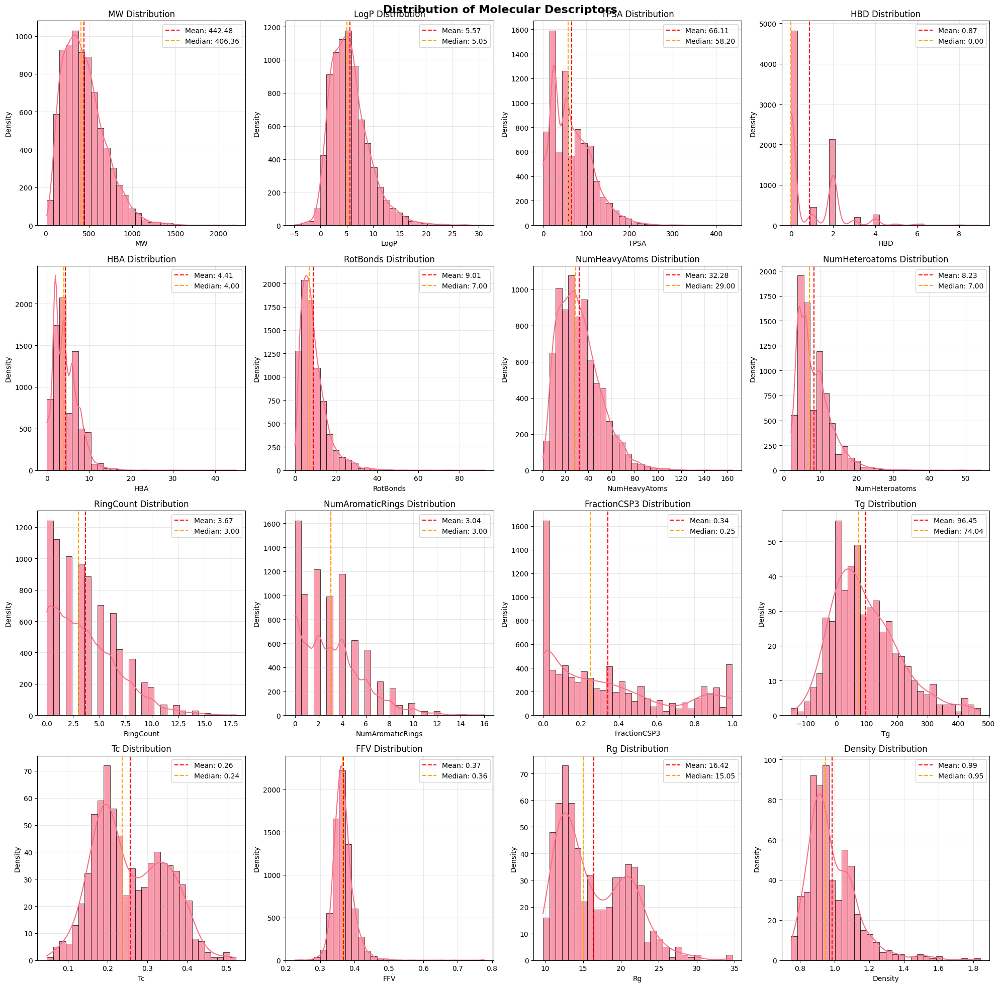

In [ ]:
# Create visualizations for molecular descriptors
import matplotlib.pyplot as plt
fig, axes = plt.subplots(4, 4, figsize=(20, 20)) # Increased grid size to 4x4
fig.suptitle('Distribution of Molecular Descriptors', fontsize=16, fontweight='bold')

# Define descriptors to plot
descriptors_to_plot = ['MW', 'LogP', 'TPSA', 'HBD', 'HBA', 'RotBonds','NumHeavyAtoms','NumHeteroatoms','RingCount','NumAromaticRings', 'FractionCSP3','Tg','Tc','FFV','Rg','Density'] # Corrected typo in FFV

# Flatten the axes array for easy iteration
axes = axes.flatten()

for i, descriptor in enumerate(descriptors_to_plot):
    # Use the flattened axes array
    ax = axes[i]

    # Create histogram with density curve
    sns.histplot(data=df_with_descriptors, x=descriptor, bins=30, kde=True, ax=ax, alpha=0.7, # Added dropna() to handle NaNs
                       edgecolor='black', linewidth=0.5)


    # Add statistical information
    mean_val = df_with_descriptors[descriptor].mean()
    median_val = df_with_descriptors[descriptor].median()
    ax.axvline(mean_val, color='red', linestyle='--',
                          label=f'Mean: {mean_val:.2f}')
    ax.axvline(median_val, color='orange', linestyle='--',
                          label=f'Median: {median_val:.2f}')

    ax.set_title(f'{descriptor} Distribution')
    ax.set_xlabel(descriptor)
    ax.set_ylabel('Density')
    ax.legend()
    ax.grid(True, alpha=0.3)

# Hide any unused subplots if the number of descriptors is less than the grid size
for j in range(i + 1, len(axes)):
    fig.delaxes(axes[j])


plt.tight_layout()
plt.show()

### Correlation Analysis

`DataFrame.corr()` is a useful function for this, it calculates pairwise correlation coefficients between numerical columns. This is essential for understanding which descriptors are related and might provide redundant information.


Correlation Matrix for Molecular Descriptors:
                     Tg     Tc    FFV     Rg  Density     MW   LogP   TPSA  \
Tg                1.000  0.033    NaN  0.180    0.235  0.251  0.110  0.213   
Tc                0.033  1.000  0.150  0.555   -0.488  0.440  0.554  0.233   
FFV                 NaN  0.150  1.000  0.053   -0.214  0.162  0.305 -0.216   
Rg                0.180  0.555  0.053  1.000    0.091  0.339  0.257  0.265   
Density           0.235 -0.488 -0.214  0.091    1.000  0.046 -0.241  0.260   
MW                0.251  0.440  0.162  0.339    0.046  1.000  0.834  0.679   
LogP              0.110  0.554  0.305  0.257   -0.241  0.834  1.000  0.257   
TPSA              0.213  0.233 -0.216  0.265    0.260  0.679  0.257  1.000   
HBD               0.112  0.424 -0.331  0.330   -0.046  0.053 -0.027  0.294   
HBA               0.147  0.084 -0.148  0.167    0.344  0.699  0.323  0.913   
RotBonds         -0.321  0.723 -0.026  0.345   -0.302  0.547  0.518  0.404   
NumHeavyAtoms     

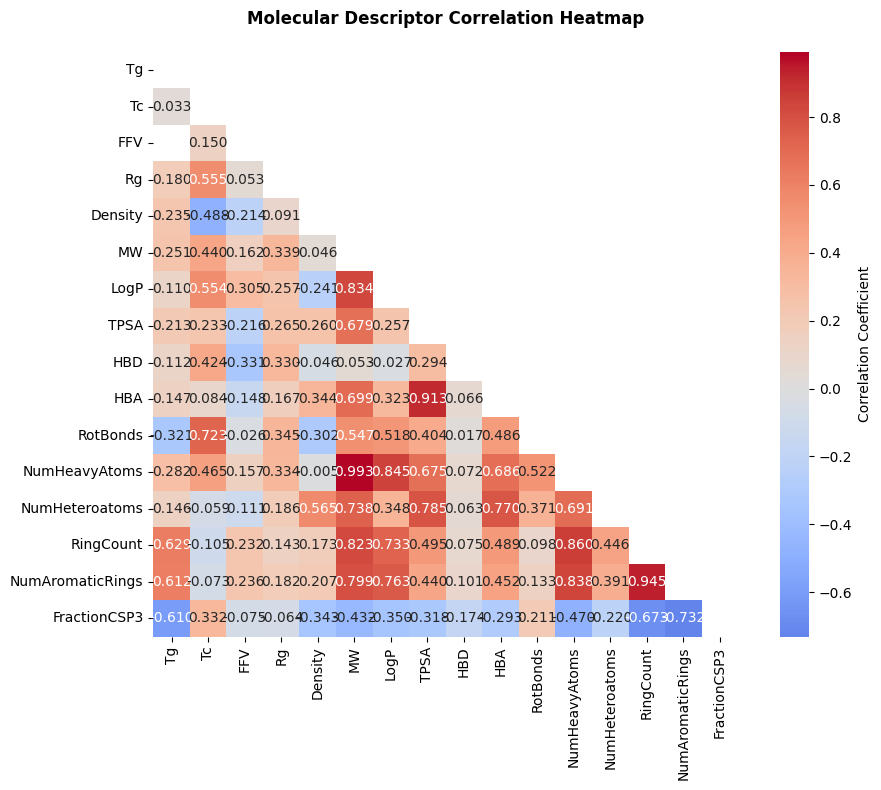

In [ ]:
# Calculate correlation matrix for molecular descriptors
descriptor_cols = ['Tg','Tc','FFV','Rg','Density','MW', 'LogP', 'TPSA', 'HBD', 'HBA', 'RotBonds','NumHeavyAtoms','NumHeteroatoms','RingCount','NumAromaticRings', 'FractionCSP3'] # Corrected typo in FFV



# Calculate correlation matrix using .corr()
correlation_matrix = df_with_descriptors[descriptor_cols].corr()

# Display correlation matrix
print("Correlation Matrix for Molecular Descriptors:")
print(correlation_matrix.round(3))

# Create correlation heatmap
plt.figure(figsize=(10, 8))

# Use seaborn for a more informative heatmap
mask = np.triu(np.ones_like(correlation_matrix, dtype=bool))  # Mask upper triangle
sns.heatmap(correlation_matrix,
            mask=mask,
            annot=True,
            cmap='coolwarm',
            center=0,
            square=True,
            fmt='.3f',
            cbar_kws={'label': 'Correlation Coefficient'})

plt.title('Molecular Descriptor Correlation Heatmap', fontweight='bold', pad=20)
plt.tight_layout()
plt.show()

### Filtering Data

- `loc[]`: enables **label-based** indexing and conditional filtering of rows.  
- `iloc[]`: provides **integer-based** indexing, letting you select rows or columns by their numeric position.

Below we filter molecules that satisfy **Lipinski’s Rule of Five**, a common guideline for drug-likeness:

- Molecular weight (MW) ≤ 500  
- LogP (octanol–water partition coefficient) ≤ 5  
- Hydrogen bond donors (HBD) ≤ 5  
- Hydrogen bond acceptors (HBA) ≤ 10    

In [ ]:
# Calculate correlation matrix for molecular descriptors
descriptor_cols = ['Tg','Tc','FFV','Rg','Density','MW', 'LogP', 'TPSA', 'HBD', 'HBA', 'RotBonds','NumHeavyAtoms','NumHeteroatoms','RingCount','NumAromaticRings', 'FractionCSP3']

target_properties = ['Tg', 'Tc', 'FFV', 'Rg', 'Density']

# Calculate correlation matrix using .corr()
# Ensure all relevant columns are included in the correlation matrix calculation
all_cols_for_correlation = target_properties + [col for col in descriptor_cols if col not in target_properties]
correlation_matrix = df_with_descriptors[all_cols_for_correlation].corr()

# Rank correlations for each target property and display as tables
print("\nRanking of Correlations with Target Properties (Tables):")
for target in target_properties:
    # Get the correlation values for the current target property with ALL other columns
    correlations = correlation_matrix[target]

    # Sort the correlation values by their absolute value in descending order
    # Include the target's self-correlation
    sorted_correlations = correlations.abs().sort_values(ascending=False)

    # Create a DataFrame to display the ranked correlations
    ranked_df = pd.DataFrame({
        'Column': sorted_correlations.index,
        'Absolute Correlation': sorted_correlations.values,
        'Original Correlation': [correlation_matrix.loc[column, target] for column in sorted_correlations.index]
    })

    print(f"\n--- Correlations with {target} (ranked by absolute value): ---")
    display(ranked_df)

# You can also visualize this as bar plots if preferred
# import matplotlib.pyplot as plt
# import seaborn as sns

# print("\nGenerating Bar Plots for Top 10 Correlated Descriptors:")
# for target in target_properties:
#     correlations = correlation_matrix[target].drop(target)
#     sorted_correlations = correlations.abs().sort_values(ascending=False).head(10) # Top 10

#     plt.figure(figsize=(10, 6))
#     sns.barplot(x=sorted_correlations.index, y=sorted_correlations.values, palette='viridis')
#     plt.title(f'Top 10 Descriptors by Absolute Correlation with {target}')
#     plt.xlabel('Descriptor')
#     plt.ylabel('Absolute Correlation')
#     plt.xticks(rotation=45, ha='right')
#     plt.tight_layout()
#     plt.show()


Ranking of Correlations with Target Properties (Tables):

--- Correlations with Tg (ranked by absolute value): ---


,Column,Absolute Correlation,Original Correlation
0,Tg,1.000000,1.000000
1,RingCount,0.628617,0.628617
2,NumAromaticRings,0.612252,0.612252
3,FractionCSP3,0.610485,-0.610485
4,RotBonds,0.320607,-0.320607
5,NumHeavyAtoms,0.281691,0.281691
6,MW,0.250809,0.250809
7,Density,0.235291,0.235291
8,TPSA,0.212706,0.212706
9,Rg,0.180072,0.180072



--- Correlations with Tc (ranked by absolute value): ---


,Column,Absolute Correlation,Original Correlation
0,Tc,1.000000,1.000000
1,RotBonds,0.722609,0.722609
2,Rg,0.554758,0.554758
3,LogP,0.554276,0.554276
4,Density,0.488476,-0.488476
5,NumHeavyAtoms,0.464714,0.464714
6,MW,0.439685,0.439685
7,HBD,0.424403,0.424403
8,FractionCSP3,0.331863,0.331863
9,TPSA,0.233444,0.233444



--- Correlations with FFV (ranked by absolute value): ---


,Column,Absolute Correlation,Original Correlation
0,FFV,1.000000,1.000000
1,HBD,0.330979,-0.330979
2,LogP,0.305414,0.305414
3,NumAromaticRings,0.235873,0.235873
4,RingCount,0.232342,0.232342
5,TPSA,0.215766,-0.215766
6,Density,0.214185,-0.214185
7,MW,0.161901,0.161901
8,NumHeavyAtoms,0.156700,0.156700
9,Tc,0.149878,0.149878



--- Correlations with Rg (ranked by absolute value): ---


,Column,Absolute Correlation,Original Correlation
0,Rg,1.000000,1.000000
1,Tc,0.554758,0.554758
2,RotBonds,0.344738,0.344738
3,MW,0.338763,0.338763
4,NumHeavyAtoms,0.334163,0.334163
5,HBD,0.330302,0.330302
6,TPSA,0.264673,0.264673
7,LogP,0.256600,0.256600
8,NumHeteroatoms,0.186147,0.186147
9,NumAromaticRings,0.182404,0.182404



--- Correlations with Density (ranked by absolute value): ---


,Column,Absolute Correlation,Original Correlation
0,Density,1.000000,1.000000
1,NumHeteroatoms,0.565235,0.565235
2,Tc,0.488476,-0.488476
3,HBA,0.343688,0.343688
4,FractionCSP3,0.342693,-0.342693
5,RotBonds,0.301770,-0.301770
6,TPSA,0.260343,0.260343
7,LogP,0.241021,-0.241021
8,Tg,0.235291,0.235291
9,FFV,0.214185,-0.214185


Generating scatter plots for top correlated descriptors:

--- Plots for Tg ---


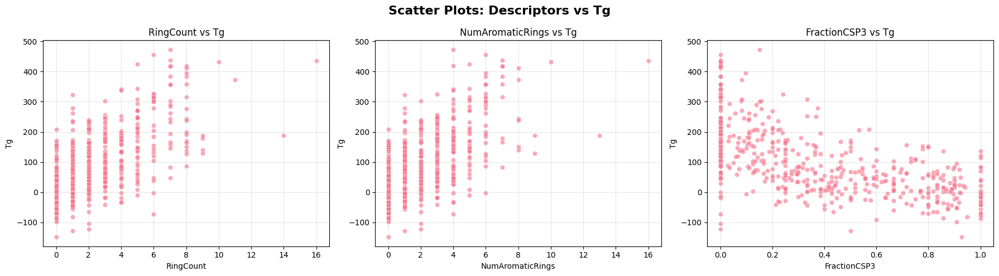


--- Plots for Tc ---


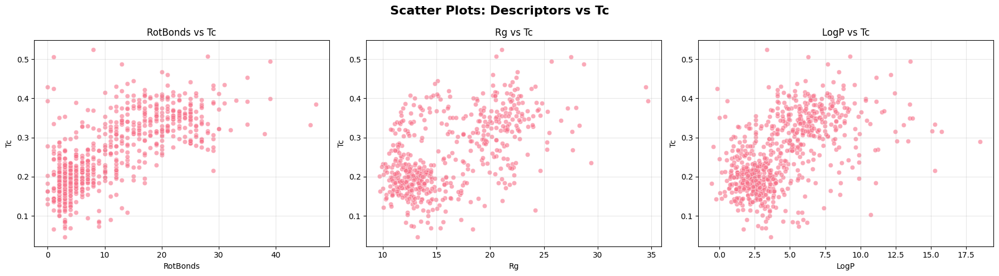


--- Plots for FFV ---


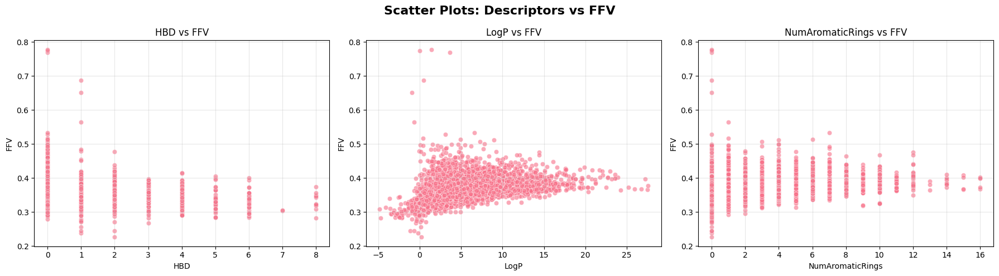


--- Plots for Rg ---


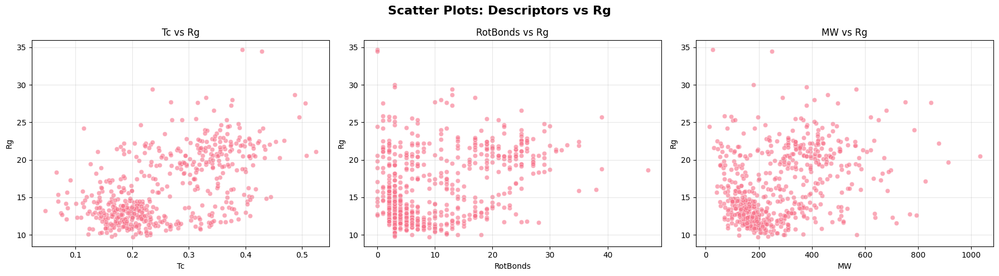


--- Plots for Density ---


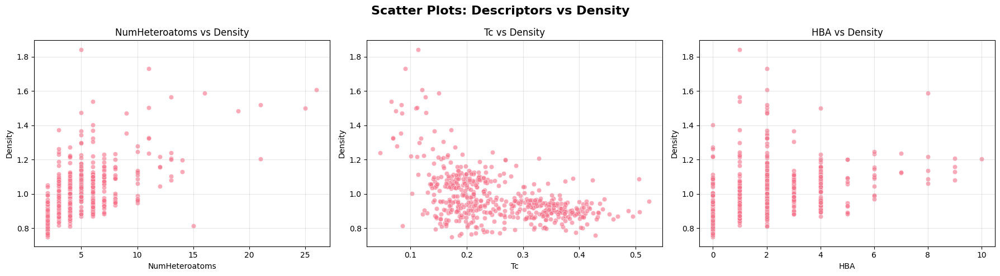

In [ ]:
# Import libraries for plotting
import matplotlib.pyplot as plt
import seaborn as sns

# Define target properties and the top N descriptors to visualize for each
target_properties = ['Tg', 'Tc', 'FFV', 'Rg', 'Density']
num_top_descriptors = 3 # Visualize top 3 correlated descriptors for each target

# Get the correlation matrix (assuming it's already calculated in df_with_descriptors)
# If not, you would need to recalculate it here:
descriptor_cols = ['Tg','Tc','FFV','Rg','Density','MW', 'LogP', 'TPSA', 'HBD', 'HBA', 'RotBonds','NumHeavyAtoms','NumHeteroatoms','RingCount','NumAromaticRings', 'FractionCSP3']
# Ensure df_with_descriptors is accessible
if 'df_with_descriptors' not in locals() and 'df_with_descriptors' not in globals():
    print("df_with_descriptors not found. Please run the cell that creates it.")
else:
    correlation_matrix = df_with_descriptors[descriptor_cols].corr()


    print("Generating scatter plots for top correlated descriptors:")

    for target in target_properties:
        print(f"\n--- Plots for {target} ---")
        # Get the correlation values for the current target property, excluding self-correlation
        correlations = correlation_matrix[target].drop(target)

        # Sort the absolute correlation values in descending order and get the top N descriptor names
        top_descriptors = correlations.abs().sort_values(ascending=False).head(num_top_descriptors).index.tolist()

        # Create scatter plots for the top descriptors
        if top_descriptors:
            # Determine the number of rows and columns for subplots
            n_plots = len(top_descriptors)
            n_cols = 3 # You can adjust the number of columns
            n_rows = (n_plots + n_cols - 1) // n_cols

            fig, axes = plt.subplots(n_rows, n_cols, figsize=(n_cols * 6, n_rows * 5))
            fig.suptitle(f'Scatter Plots: Descriptors vs {target}', fontsize=16, fontweight='bold')
            axes = axes.flatten() # Flatten the axes array for easy iteration

            for i, descriptor in enumerate(top_descriptors):
                ax = axes[i]
                sns.scatterplot(data=df_with_descriptors, x=descriptor, y=target, ax=ax, alpha=0.6)
                ax.set_title(f'{descriptor} vs {target}')
                ax.set_xlabel(descriptor)
                ax.set_ylabel(target)
                ax.grid(True, alpha=0.3)

            # Hide any unused subplots
            for j in range(i + 1, len(axes)):
                fig.delaxes(axes[j])

            plt.tight_layout()
            plt.show()
        else:
            print(f"No top descriptors found for {target} (or perhaps correlation matrix was not available).")

Generating scatter plots for target properties against each other:


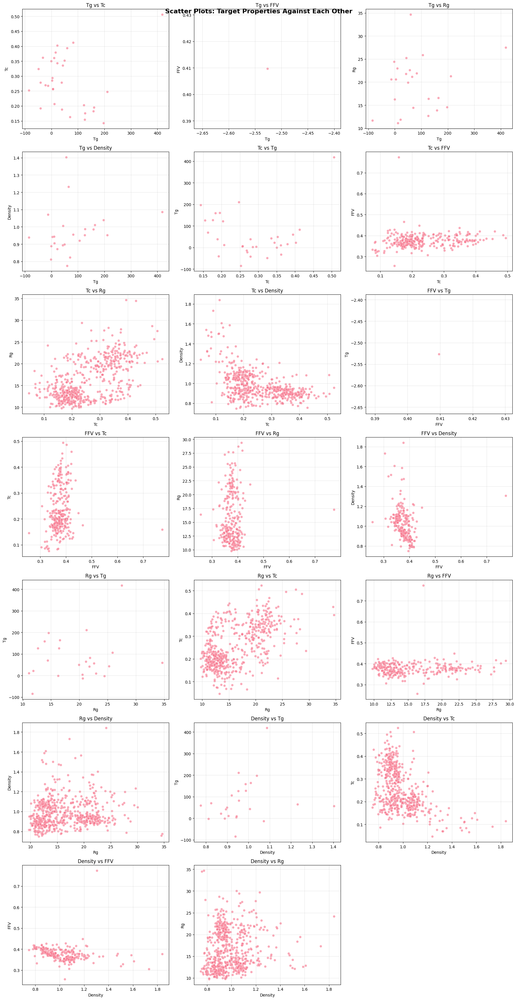

In [ ]:
# Generate scatter plots for each target property vs. other target properties
target_properties = ['Tg', 'Tc', 'FFV', 'Rg', 'Density']

print("Generating scatter plots for target properties against each other:")

# Calculate the number of plots needed (excluding self-vs-self)
n_plots = len(target_properties) * (len(target_properties) - 1)

# Define the number of columns for the grid
n_cols = 3
# Calculate the number of rows needed
n_rows = (n_plots + n_cols - 1) // n_cols

fig, axes = plt.subplots(n_rows, n_cols, figsize=(n_cols * 6, n_rows * 5))
fig.suptitle('Scatter Plots: Target Properties Against Each Other', fontsize=16, fontweight='bold')
axes = axes.flatten() # Flatten the axes array for easy iteration

plot_index = 0
for i in range(len(target_properties)):
    for j in range(len(target_properties)):
        # Avoid plotting a property against itself
        if i != j:
            target1 = target_properties[i]
            target2 = target_properties[j]

            ax = axes[plot_index]
            sns.scatterplot(data=df_with_descriptors, x=target1, y=target2, ax=ax, alpha=0.6)
            ax.set_title(f'{target1} vs {target2}')
            ax.set_xlabel(target1)
            ax.set_ylabel(target2)
            ax.grid(True, alpha=0.3)

            plot_index += 1

# Hide any unused subplots
for j in range(plot_index, len(axes)):
    fig.delaxes(axes[j])

plt.tight_layout()
plt.show()

In [ ]:
# Exercise 3 solution space


# 7. Using `ydata-profiling` for EDA

`ydata-profiling` (formerly known as `pandas-profiling`) is an automated data analysis tool for Python. It generates interactive, comprehensive reports that summarize the structure, quality, and statistics of your dataset with just a few lines of code.

Key features include:

- **Data overview:** Quickly see column types, missing values, and sample data.
- **Descriptive statistics:** Get distributions, quantiles, and summary stats for each variable.
- **Correlation analysis:** Visualize relationships between features.
- **Missing value analysis:** Identify patterns and locations of missing data.
- **Interactive HTML reports:** Explore your data visually and share results easily.

This tool is especially useful for exploratory data analysis (EDA), helping you understand your dataset and spot potential issues before building models.


### Installing `ydata-profiling`

To use the `ydata-profiling` package for automated EDA reports, you need to install it first.

**In your local terminal:**
```bash
pip install ydata-profiling
```

**In Google Colab:**
```python
!pip install ydata-profiling
```
```

In [ ]:
!pip install ydata-profiling

In [ ]:
from ydata_profiling import ProfileReport

In [ ]:
# Generate report
profile = ProfileReport(df_with_descriptors, title="EDA Report", explorative=True)

In [ ]:
profile

# html = profile.to_html(index = False)
# pdfkit.from_string(html, 'eda_report.pdf')

# print("Aaved pdf")

Summarize dataset:   0%|          | 0/5 [00:00<?, ?it/s]


100%|██████████| 20/20 [00:01<00:00, 16.83it/s]


Generate report structure:   0%|          | 0/1 [00:00<?, ?it/s]

Render HTML:   0%|          | 0/1 [00:00<?, ?it/s]

In [ ]:
# Save to file
#profile.to_file("eda_report.html")


NameError: name 'pdfkit' is not defined

In [ ]:
Gen it here plzeeea

# 8. Molecular Featurization

**Molecular featurization** is the process of converting molecular structures into numerical vectors (feature vectors) that machine learning algorithms can process, while preserving important chemical information.

We've already explored the main categories:

1. **Molecular Descriptors** (Section 3): Numerical properties like MW, LogP, TPSA
   - Capture global molecular properties
   - Directly interpretable
   - Usually 10-200 features

2. **Molecular Fingerprints** (Section 4): Binary vectors encoding structural patterns
   - Capture local structural environments
   - High-dimensional (1024-4096 bits)
   - Excellent for similarity comparisons

Now that we've mastered the use of pandas (Section 5) we can proceed to feature vector construction. Let's get the Morgan fingerprints of the ClinTox dataset.

In [ ]:
morgan_gen = rdFingerprintGenerator.GetMorganGenerator(radius=2, fpSize=1024)

# Generate fingerprints for all molecules
fingerprints = []
for mol in df_with_descriptors['molecule']:
    fp = morgan_gen.GetFingerprint(mol)
    fingerprints.append(fp.ToList())

# Convert to DataFrame with indexed column names
fp_columns = [f'Morgan_bit_{i}' for i in range(1024)]
fingerprint_df = pd.DataFrame(fingerprints, columns=fp_columns, index=df_with_descriptors.index)

print(f"Dataframe of fingerprints shape: {fingerprint_df.shape}")
print(f"First molecule has {sum(fingerprints[0])} bits set out of 1024")

### Mini Exercise 4:

 **Compare Similar Molecules:**
   - Select 10  molecules from the dataset (any indices you choose)
   - Calculate their Tanimoto similarity using their Morgan fingerprints
   - Create a similarity matrix and identify which pair is most similar


In [ ]:
# Exercise 4 Solution Space


Thank you!